In [1]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

import os
os.chdir("C:/Users/kaborg15/PycharmProjects/FREja_API/")

In [4]:
import pandas as pd

OUTFITS_DF_PATH = r"resources\style_quiz_resources\autoencoded_outfits_dl_df.pkl"
outfits_df = pd.read_pickle(OUTFITS_DF_PATH)
outfits_df.head(2)

,id,owner_x,name,description,meta.validTo,isPublic,keywords,outfit_tags,tag_categories,Outfit_size,...,material,all_materials,occasion,all_occasions,season,all_seasons,details,all_details,color,all_colors
0,outfit.5c081909537b42239e465d2d615c705f,user.adaf918fc0364873a48255897a2b13d8,Naos Yellow Down Vest,The Naos Down Vest is a vest fest in nineties ...,9999-01-01 00:00:00,1,outfit.5c081909537b42239e465d2d615c705f - Naos...,"[Winter, Synthetic, Yellow, Everyday, Fall, M,...","[Seasons, Material, Color, Occasion, Seasons, ...",[M],...,Synthetic,[Synthetic],Everyday,"[Everyday, Active]",Winter,"[Winter, Fall]",None,None,Yellow,[Yellow]
1,outfit.c34969dd8b334064aa90bfb60c8ec308,user.f7ccce52cdd74783b7edfdf73b49ccfb,Lava Print Wool Jacket,The Lava Print Wool Jacket is both classy and ...,9999-01-01 00:00:00,1,outfit.c34969dd8b334064aa90bfb60c8ec308 - Lava...,"[Wool, Synthetic, Jackets, Everyday, Fall, Sum...","[Material, Material, Category, Occasion, Seaso...",[S],...,Wool,"[Wool, Synthetic]",Everyday,[Everyday],Fall,"[Fall, Summer, Spring]",None,None,Beige,"[Beige, Multicolor, Brown, Blue]"


Initializing FJONG bucket...


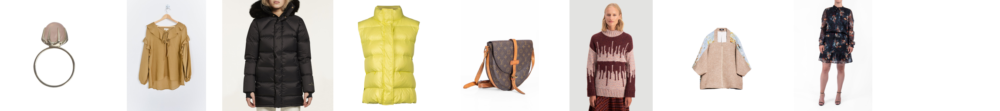

In [6]:
import random
import sys
sys.path.append("C:/Users/kaborg15/PycharmProjects/fashion-clip")

from fashion_clip.fashion_clip import display_images
from fashion_clip.load_images_from_FJONG import retrieve_picture_ids, get_bucket, download_picture

class ImageDisplay:
    def __init__(self):
        self.bucket = None

    def display_images_from_fjong(self, image_ids, images_path="resources/fjong_images", **kwargs):
        if self.bucket is None:
            print("Initializing FJONG bucket...")
            self.bucket = get_bucket()
        image_paths = []
        #print(f"printing image paths: {image_ids}")
        for img_id in image_ids:
            img_id = img_id.split(os.path.sep)[-1]
            download_path = f"{images_path}/{img_id}"
            if not os.path.isfile(download_path):
                download_picture(self.bucket, img_id, save_file_name=download_path)
            if os.path.isfile(download_path):
                image_paths.append(download_path)
        return display_images(image_paths, columns=9, max_images=27, plot_figure=False, **kwargs)

    def format_collage(self, image_ids):
        collage = self.display_images_from_fjong(image_ids)
        collage.thumbnail((1500, 800), Image.LANCZOS)
        return collage

from FREja_API.Update_Database_Data import get_pictures_array_from_db
from FREja_API.constants import *

RETRIEVE_FROM_DATABASE = False

if RETRIEVE_FROM_DATABASE:
    pictures_df = get_pictures_array_from_db(outfits_df["id"].values)
    pictures_df.to_pickle(os.path.join(CBM_SAVE_PATH, "manual_" + PICTURES_PATH), compression=COMPRESSION_TYPE)
else:
    pictures_df = pd.read_pickle(os.path.join(CBM_SAVE_PATH, "manual_" + PICTURES_PATH), compression=COMPRESSION_TYPE)


def get_outfit_images(outfit_ids):
    outfit_pictures = get_pictures_array_from_db(outfit_ids)
    #Get picture with lowest displayOrder
    outfit_pictures = outfit_pictures.sort_values(by="displayOrder").groupby("owner").first().reset_index()
    return outfit_pictures["id"].values

def get_outfit_images_from_df(outfit_ids, pictures_df):
    outfit_pictures = pictures_df[pictures_df["owner"].isin(outfit_ids)]
    #Get picture with lowest displayOrder
    outfit_pictures = outfit_pictures.sort_values(by="displayOrder").groupby("owner").first().reset_index()
    return outfit_pictures["id"].values

image_display = ImageDisplay()
image_display.display_images_from_fjong(get_outfit_images_from_df(outfits_df["id"].values[:8], pictures_df))


In [7]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import plotly.express as px
fig = px.scatter(outfits_df, x="tsne_x", y="tsne_y", color="category", hover_data=["id", "category", "all_categories"], width=1500, height=800)
fig.show()

Cluster 0: 2427
Cluster 1: 7874
Cluster 0:


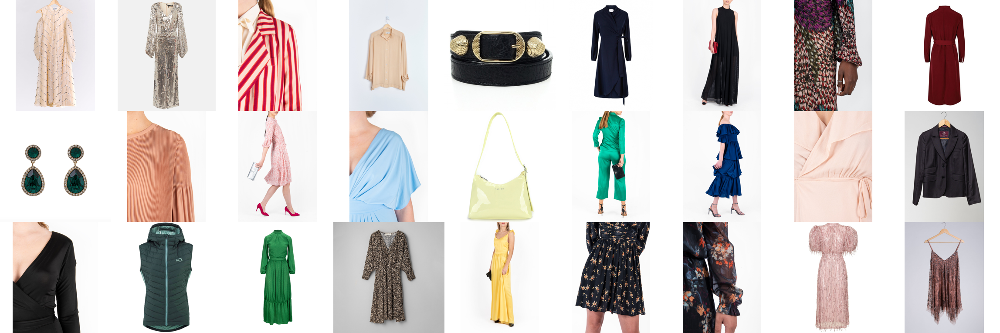

Cluster 1:


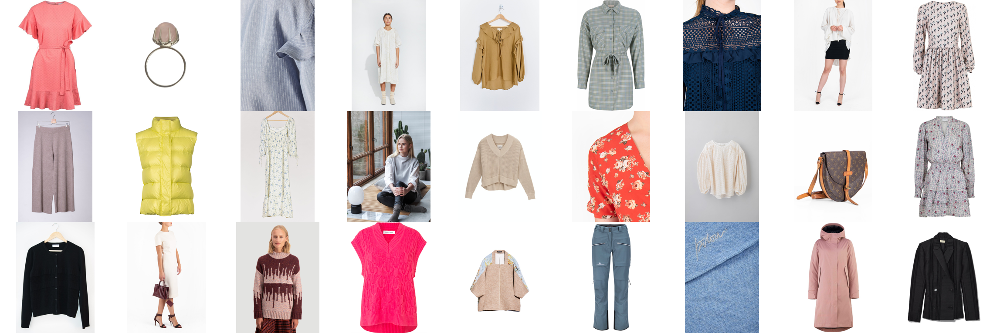

Cluster 0: 3436
Cluster 1: 4438
Cluster 0:


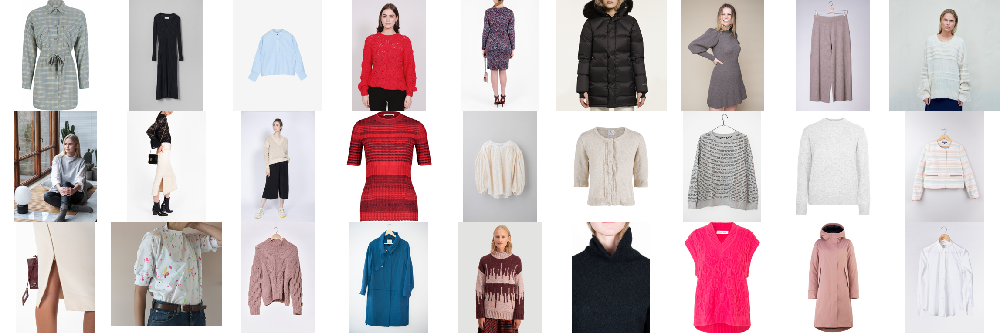

Cluster 1:


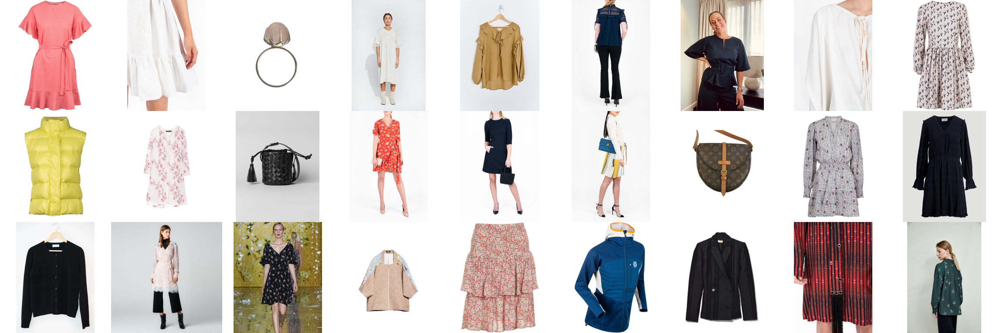

Cluster 0: 2398
Cluster 1: 2040
Cluster 0:


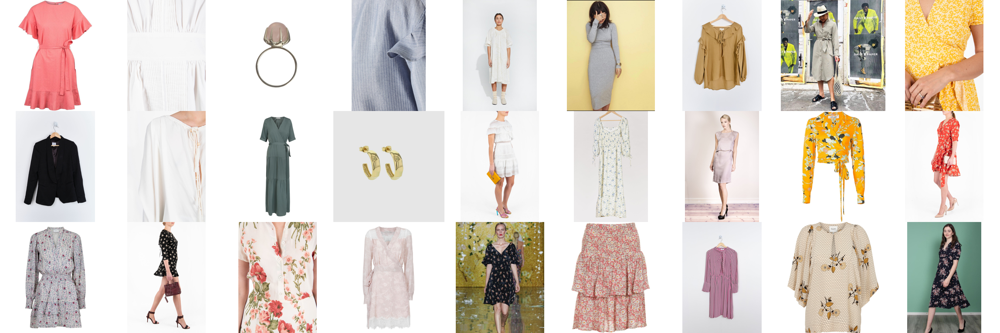

Cluster 1:


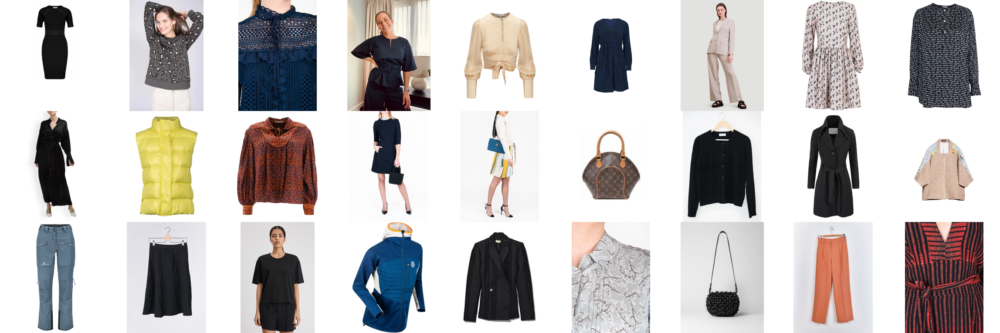

Cluster 0: 1160
Cluster 1: 1238
Cluster 0:


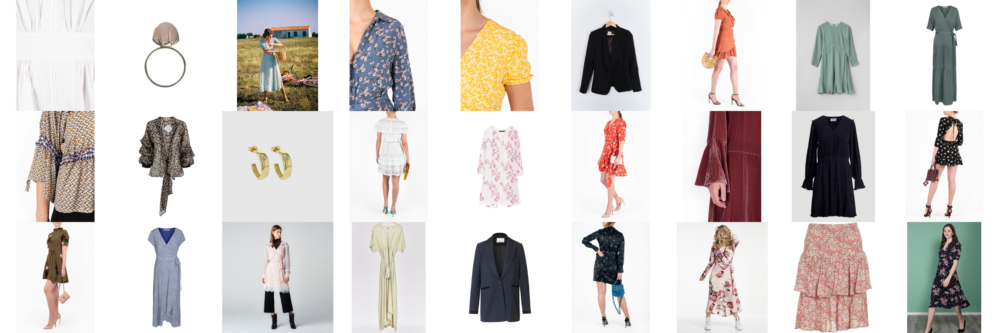

Cluster 1:


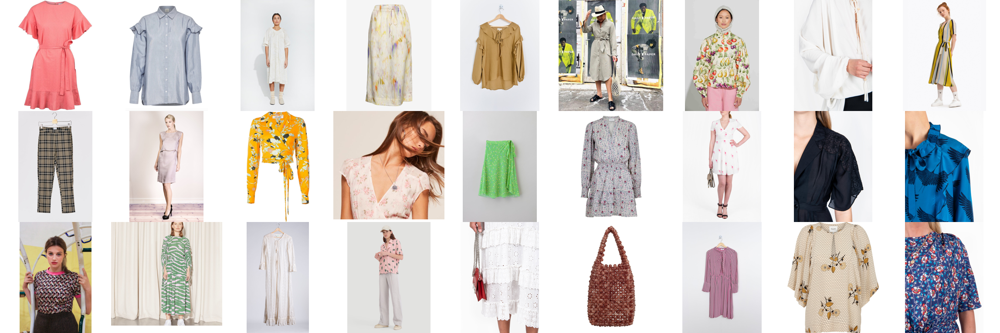

Cluster 0: 337
Cluster 1: 901
Cluster 0:


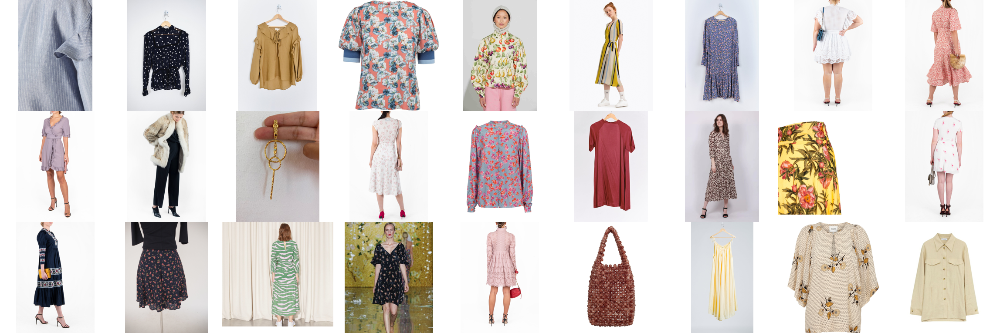

Cluster 1:


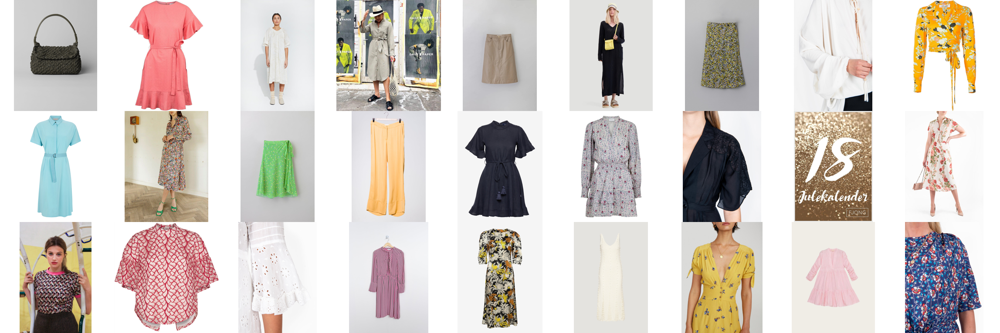

Cluster 0: 339
Cluster 1: 562
Cluster 0:


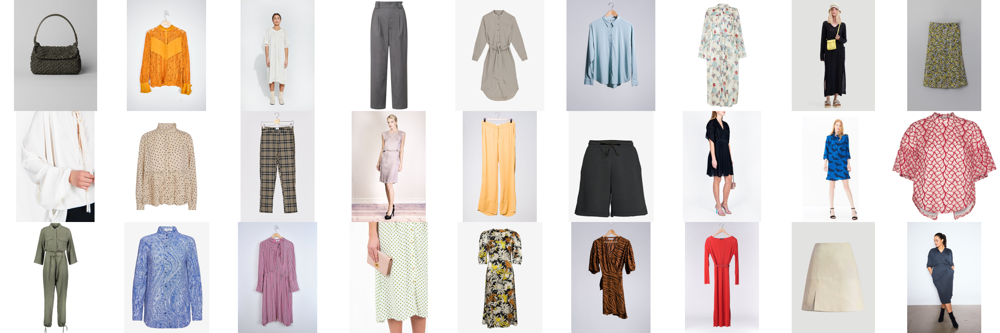

Cluster 1:


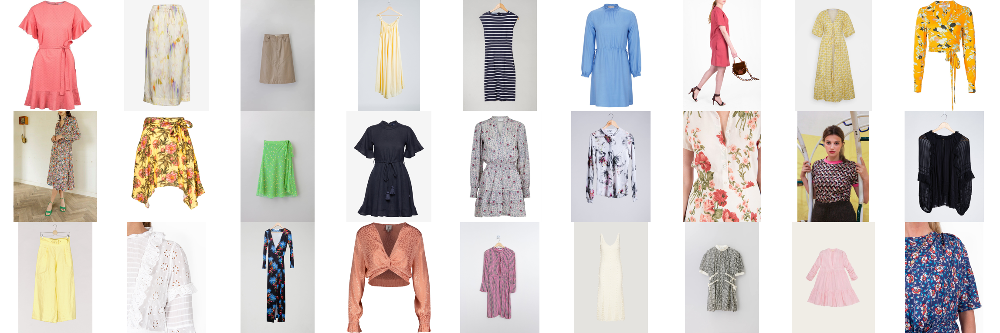

Cluster 0: 201
Cluster 1: 138
Cluster 0:


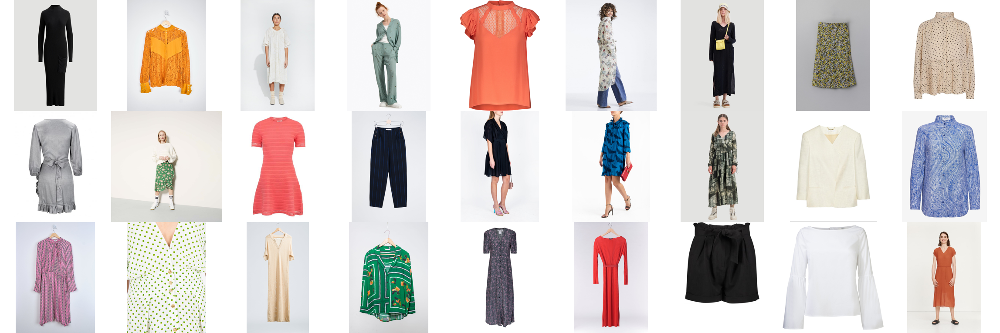

Cluster 1:


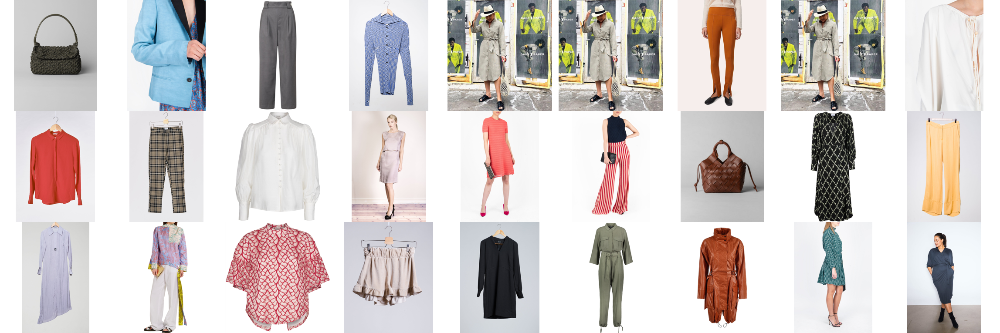

Cluster 0: 137
Cluster 1: 64
Cluster 0:


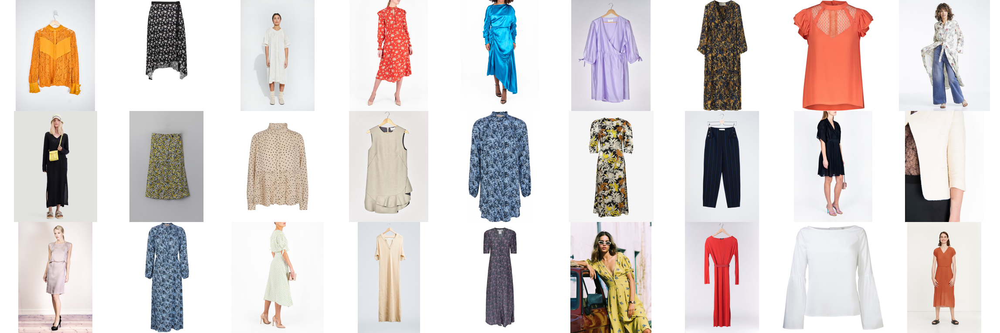

Cluster 1:


In [9]:
import time
from sklearn.cluster import KMeans
import numpy as np

REPRESENTATION_COLUMN = "autoencoder_embedding"
NUM_SAMPLES_PER_CLUSTER = 27

current_cluster_df = outfits_df.copy()
chosen_cluster = ""

while chosen_cluster != "q":
    if len(current_cluster_df) <= NUM_SAMPLES_PER_CLUSTER:
        print("Converged to a single cluster.")
        break

    outfit_representations = np.stack(current_cluster_df[REPRESENTATION_COLUMN].values)
    kmeans = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(outfit_representations)
    current_cluster_df["cluster"] = kmeans.labels_

    cluster_samples = []
    for i in range(2):
        cluster_outfits = current_cluster_df[current_cluster_df["cluster"] == i].copy()
        cluster_embeddings = np.stack(cluster_outfits[REPRESENTATION_COLUMN].values)
        num_cluster_samples = min(NUM_SAMPLES_PER_CLUSTER, len(cluster_outfits))
        cluster_kmeans = KMeans(n_clusters=num_cluster_samples, random_state=1, n_init="auto").fit(cluster_embeddings)
        cluster_outfits["representation_cluster"] = cluster_kmeans.labels_
        cluster_representation = cluster_outfits.groupby("representation_cluster").first().reset_index()
        cluster_samples.append(cluster_representation)
        print(f"Cluster {i}: {len(cluster_outfits)}")

    for i, cluster in enumerate(cluster_samples):
        print(f"Cluster {i}:")
        #display(image_display.display_images_from_fjong(get_outfit_images(cluster["id"].values)))
        cluster_collage = image_display.display_images_from_fjong(get_outfit_images_from_df(cluster["id"].values, pictures_df))
        display(cluster_collage)

    time.sleep(1)
    chosen_cluster = ""
    while chosen_cluster not in ["0", "1", "q"]:
        chosen_cluster = input("Choose cluster: ")

    if chosen_cluster == "q":
        break
    
    chosen_cluster = int(chosen_cluster)
    current_cluster_df = current_cluster_df[current_cluster_df["cluster"] == chosen_cluster].copy()

print("Final cluster: ")
display(cluster_collage)

In [90]:
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import SpectralClustering
import time
import numpy as np

REPRESENTATION_COLUMN = "autoencoder_embedding"
NUM_SAMPLES_PER_CLUSTER = 27

current_cluster_df = outfits_df.copy()
chosen_cluster = ""

outfit_representations = np.stack(current_cluster_df[REPRESENTATION_COLUMN].values)
# db = DBSCAN(eps=0.5, min_samples=5).fit(outfit_representations)
# current_cluster_df["cluster"] = db.labels_

# agc = AgglomerativeClustering(n_clusters=3).fit(outfit_representations)
# current_cluster_df["cluster"] = agc.labels_

spc = SpectralClustering(n_clusters=3).fit(outfit_representations)
current_cluster_df["cluster"] = spc.labels_

In [89]:
current_cluster_df["cluster"].value_counts()

cluster
0    8534
1    1767
Name: count, dtype: int64